# PROJETO_BD1 - projeto de análise do banco de dados kc_house_data.csv que foi carregado do site kaggle.com. Esse banco de dados tem como escopo ofertar avaliações técnicas de imóveis da região de King county, do estado de Washington, capital do Estados Unidos, com dados históricos entre maio de 2014 e maio de 2015. Aqui será feita uma análise gráfica de comparação de valores sobre as características dos imóveis.

# Autor - Fábio Clericuzi

In [2]:
# Importando as bibliotecas

import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import matplotlib
import pandas_profiling
import seaborn as sns

%matplotlib inline

In [3]:
# Carregando os arquivos

arquivo = 'kc_house_data.csv'
dataset = pd.read_csv(arquivo, sep=',', header=0)

In [4]:
# Visualizando os 5 primeiras linhas do dataframe.

dataset.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3.0,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3.0,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2.0,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4.0,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3.0,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [6]:
# visualizando o número de linhas das colunas do dataframe.

dataset.count()

id               21613
date             21613
price            21613
bedrooms         21609
bathrooms        21613
sqft_living      21613
sqft_lot         21613
floors           21612
waterfront       21613
view             21613
condition        21613
grade            21613
sqft_above       21613
sqft_basement    21613
yr_built         21613
yr_renovated     21613
zipcode          21613
lat              21613
long             21613
sqft_living15    21613
sqft_lot15       21613
dtype: int64

In [9]:
# Imprimindo as informações do dataframe(colunas e memória)

dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21609 non-null  float64
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21612 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [7]:
# Começando a análise utilizando o pandas_profiling para gerar um relatório dos dados.

pandas_profiling.ProfileReport(dataset)

In [8]:
# Verificando colunas com valores nulos.

dataset.isnull().sum()

id               0
date             0
price            0
bedrooms         4
bathrooms        0
sqft_living      0
sqft_lot         0
floors           1
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [9]:
# Removendo colunas com valores faltantes.

dataset.dropna(inplace=True)

In [10]:
# Verificando o dataset após a remoção das colunas com dados nulos.

dataset.isnull().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

Iniciando a visualização dos dados


In [11]:
# Imprimindo a correlação de Person das colunas do dataframe.

dataset.corr()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,-0.016763,0.001345,0.005402,-0.012116,-0.132130,0.018751,-0.002717,0.011610,-0.023791,0.008244,-0.010675,-0.005170,0.021532,-0.016899,-0.008267,-0.001911,0.020944,-0.002721,-0.138825
price,-0.016763,1.000000,0.308323,0.525191,0.702060,0.089630,0.256885,0.266372,0.397274,0.036347,0.667424,0.605628,0.323753,0.054084,0.126410,-0.053330,0.306911,0.021593,0.585443,0.082410
bedrooms,0.001345,0.308323,1.000000,0.515881,0.576653,0.031671,0.175440,-0.006596,0.079499,0.028598,0.356954,0.477579,0.303094,0.154141,0.018813,-0.152669,-0.008900,0.129467,0.391633,0.029206
bathrooms,0.005402,0.525191,0.515881,1.000000,0.754642,0.087739,0.500584,0.063744,0.187735,-0.124963,0.664980,0.685298,0.283805,0.505985,0.050728,-0.203879,0.024593,0.222956,0.568570,0.087176
sqft_living,-0.012116,0.702060,0.576653,0.754642,1.000000,0.172818,0.353914,0.103816,0.284602,-0.058715,0.762691,0.876590,0.435055,0.318020,0.055346,-0.199474,0.052516,0.240158,0.756401,0.183278
sqft_lot,-0.132130,0.089630,0.031671,0.087739,0.172818,1.000000,-0.005182,0.021599,0.074694,-0.008956,0.113602,0.183520,0.015257,0.053104,0.007632,-0.129619,-0.085744,0.229526,0.144617,0.718552
floors,0.018751,0.256885,0.175440,0.500584,0.353914,-0.005182,1.000000,0.023705,0.029461,-0.263785,0.458212,0.523839,-0.245680,0.489251,0.006349,-0.059037,0.049735,0.125346,0.279790,-0.011244
waterfront,-0.002717,0.266372,-0.006596,0.063744,0.103816,0.021599,0.023705,1.000000,0.401856,0.016654,0.082769,0.072076,0.080581,-0.026158,0.092881,0.030276,-0.014294,-0.041917,0.086467,0.030698
view,0.011610,0.397274,0.079499,0.187735,0.284602,0.074694,0.029461,0.401856,1.000000,0.045992,0.251301,0.167649,0.276924,-0.053426,0.103904,0.084796,0.006099,-0.078421,0.280453,0.072557
condition,-0.023791,0.036347,0.028598,-0.124963,-0.058715,-0.008956,-0.263785,0.016654,0.045992,1.000000,-0.144695,-0.158169,0.174093,-0.361380,-0.060623,0.002923,-0.015112,-0.106518,-0.092787,-0.003400


<AxesSubplot:>

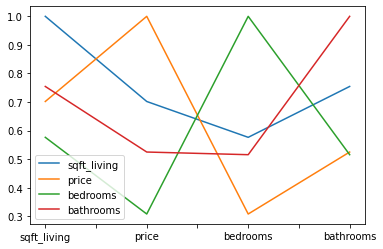

In [13]:
# Plotando a correlação dem gráficos de algumas linhas que vamos trabalhar mais a frente.
dataset[['sqft_living', 'price', 'bedrooms', 'bathrooms']].corr().plot()

<AxesSubplot:>

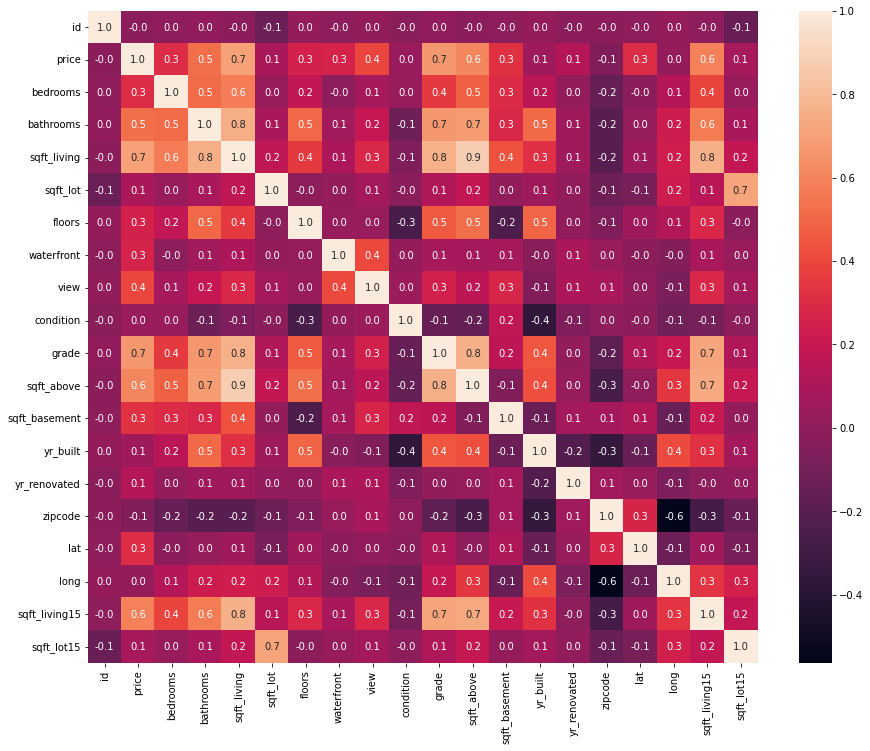

In [25]:
# visualizando as correlações.

correlacao = dataset.corr()
plt.figure(figsize = (15, 12))
sns.heatmap(correlacao, annot=True, fmt='.1f')

° Pode-se verificar na matriz acima uma correlação positiva entre as colunas de preço(price) e a quantidade de metros quadrados do interior do imóvel(sqft_living). Isso significa que, quantos maior o número de metros quadrados de um imóvel, maior o seu valor.

° Existe também uma correlação positiva entre o número de quartos e banheiros(bedrooms e bathrooms) e o preço dos imóveis(price). Isso significa que quanto maior o número de quartos e banheiros, maior o valor do imóvel.

# Vamos focar em algumas colunas para continuar a análise.

In [26]:
# indexando o dataframe com algumas colunas essenciais para facilitar a visualização.

dataset = pd.read_csv(arquivo, sep=',', index_col='date')

In [27]:
dataset = pd.read_csv(arquivo, sep=',', usecols=['id', 'date', 'price', 'bathrooms', 'bedrooms', 'sqft_living'])

In [35]:
# Visualizando as cem primeiras linhas do dataset após indexa-lo.

dataset.head(100).sort_values(by='price', ascending=False)

,id,date,price,bedrooms,bathrooms,sqft_living
21,2524049179,20140826T000000,2000000.0,3.0,2.75,3050
49,822039084,20150311T000000,1350000.0,3.0,2.50,2753
69,1802000060,20140612T000000,1325000.0,5.0,2.25,3200
5,7237550310,20140512T000000,1225000.0,4.0,4.50,5420
91,5036300431,20150311T000000,1099880.0,5.0,2.75,3520
...,...,...,...,...,...,...
68,1274500060,20140825T000000,204000.0,3.0,1.00,1000
97,1099611230,20140912T000000,199000.0,4.0,1.50,1160
18,16000397,20141205T000000,189000.0,2.0,1.00,1200
2,5631500400,20150225T000000,180000.0,2.0,1.00,770


In [29]:
# Ordenando as informações do dataset pelo preço do imóvel.
dataset.sort_values(by='price', ascending=False)

,id,date,price,bedrooms,bathrooms,sqft_living
7252,6762700020,20141013T000000,7700000.0,6.0,8.00,12050
3914,9808700762,20140611T000000,7062500.0,5.0,4.50,10040
9254,9208900037,20140919T000000,6885000.0,6.0,7.75,9890
4411,2470100110,20140804T000000,5570000.0,5.0,5.75,9200
1448,8907500070,20150413T000000,5350000.0,5.0,5.00,8000
...,...,...,...,...,...,...
8274,3883800011,20141105T000000,82000.0,3.0,1.00,860
16198,3028200080,20150324T000000,81000.0,2.0,1.00,730
465,8658300340,20140523T000000,80000.0,1.0,0.75,430
15293,40000362,20140506T000000,78000.0,2.0,1.00,780


<AxesSubplot:>

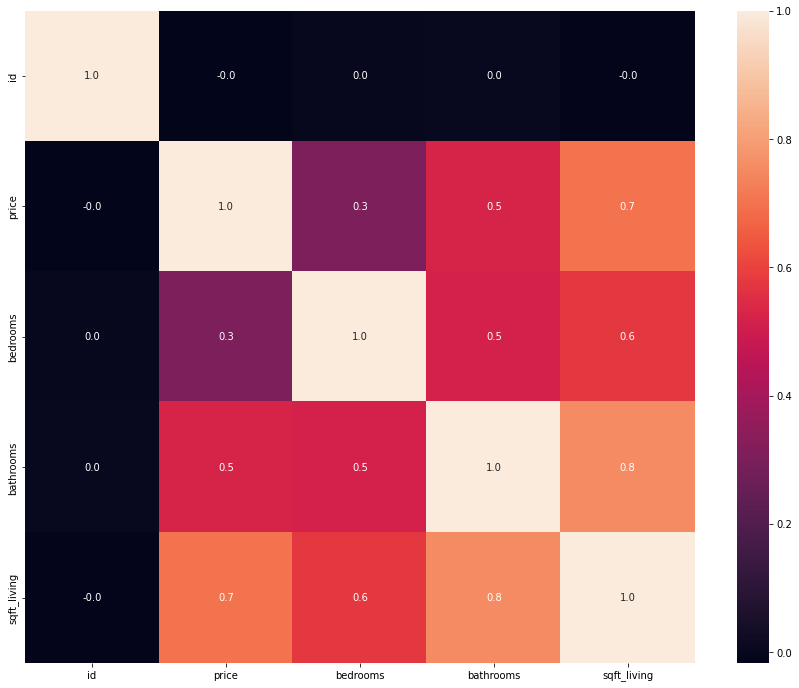

In [30]:
# Imprimindo a nova matriz de correlação

correlacao = dataset.corr()
plt.figure(figsize = (15, 12))
sns.heatmap(correlacao, annot=True, fmt='.1f')

° Com a diminuição no número de variáveis, pode-se observar melhor a correlação entre elas na matriz.

Realizando a análise gráfica do dataset

In [47]:
# Verificando o valor máximo da coluna price

dataset['price'].max()

7700000.0

In [48]:
# Verificando o valor mínimo da coluna price.

dataset['price'].min()

75000.0

In [49]:
# Verificando a média de preços.

dataset['price'].mean()

540088.1417665294

<AxesSubplot:>

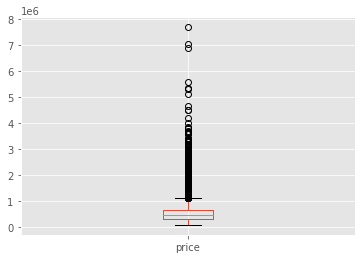

In [43]:
# Verificando a existência de outliers com gráficos Box

matplotlib.style.use('ggplot')
dataset.boxplot(column='price')

° No gráfico acima pode-se observar a existência de alguns valores que estão bem acima da média do dataset, que são chamados de "outliers". Esse tipo de valor pode atrapalhar a análise pois estão foras dos padrões da média de valores de preço dos imóveis.

array([[<AxesSubplot:title={'center':'bedrooms'}>,
        <AxesSubplot:title={'center':'bathrooms'}>]], dtype=object)

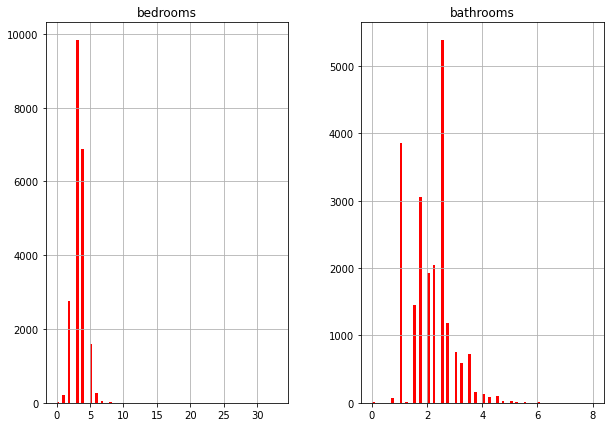

In [44]:
# plotando os histogramas das colunas separadamente das colunas 'bathrooms' e 'bedrooms'.


dataset[['bedrooms', 'bathrooms']].hist(bins=80, alpha=1.0, color='red', figsize=(10, 7))

° histograma 'bedrooms' -> Podemos perceber no gráfico que grande parte dos imóveis analisados tem uma quantidade de quartos entre 1 e 4.

° Histograma 'bathrooms' -> Podemos perceber no gráfico que o número de banheiros do imóveis estão centralizados entre 2 e quatro banheiros.

° Fazendo a comparação entre as variáveis utilizando gráficos de dispersão.

<AxesSubplot:title={'center':'Número de quartos x Preços'}, xlabel='bedrooms', ylabel='price'>

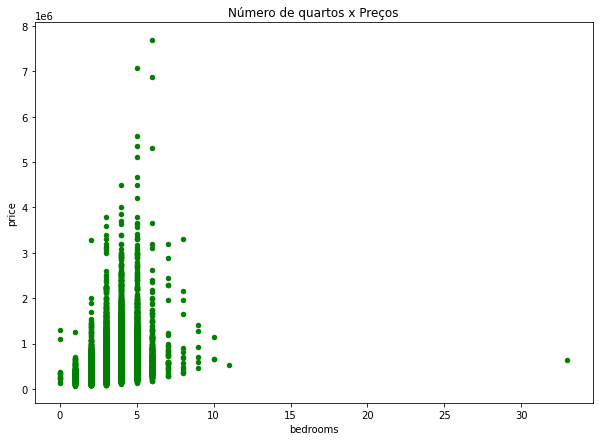

In [49]:
# Plotando gráficos de dispersão entre o preço e o número de quartos dos imóveis.

dataset.plot(x='bedrooms', y='price', kind='scatter', title='Número de quartos x Preços', color='green', figsize=(10, 7))

° Podemos ver no gráfico acima como o número de quartos influência na varável preço, verificando que, os imóveis de maior valor estão concentrados na área do gráfico onde o número de quartos é maior(imóveis com número igual o maior que 5 quartos). Podemos também verificar a existência de um outlier que é um imóvel que tem mais de 30 quartos.

<AxesSubplot:title={'center':'Número de banheiros x Preços'}, xlabel='bathrooms', ylabel='price'>

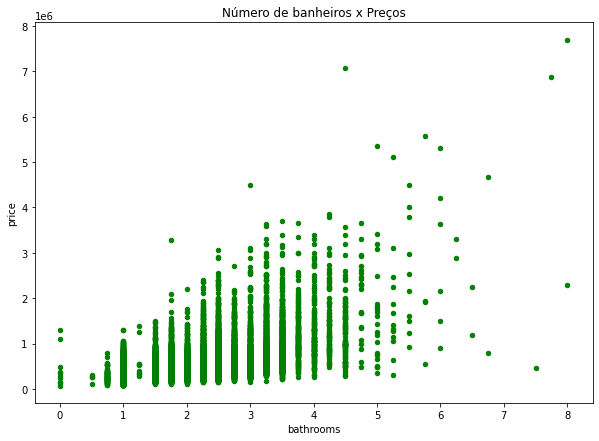

In [48]:
# Plotando gráficos de dispersão entre o preço e o número de banheiros dos imóveis.

dataset.plot(x='bathrooms', y='price', kind='scatter', title='Número de banheiros x Preços', color='green', figsize=(10, 7))

° Pode-se perceber no gráfico a existência de alguns valores que fogem a média de banheiros que tem os imóveis. Se pode observar
também que existe uma correlação positiva entre número de banheiros e os valores dos imóveis, ou seja, quanto maior o número de
banheiros de um imóvel, maior o seu valor de mercado.

<AxesSubplot:title={'center':'Número de quartos x Preços'}, xlabel='sqft_living', ylabel='price'>

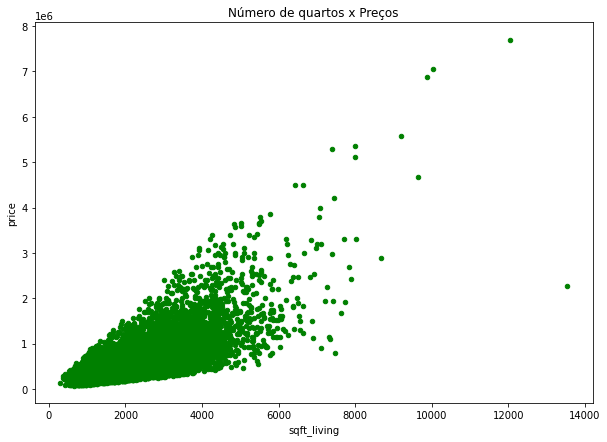

In [54]:
# Plotando gráficos de dispersão entre o preço e o número de metros quadrados dos imóveis.

dataset.plot(x='sqft_living', y='price', kind='scatter', title='Número de quartos x Preços', color='green', figsize=(10, 7))

° No gráfico acima é perceptível a grande concentração de imóveis entre 0 e 6000 mil pés, mas para melhorar a visulização dos dados, vamos criar parâmetros para a coluna 'sqft_living'. OBS: Traduzindo de forma bruta o 'sqft'(medida de tamanho dos imóveis 
nos EUA), nós pegamos os valores que estão em 'sqft' e dividimos por 10.76 para que este fique com a medida de M².

In [56]:
dataset['sqft_labels'] = pd.cut(
    dataset['sqft_living'],
    5,
    labels = ['Muito pequeno', 'Pequeno', 'Médio', 'Grande', 'Muito grande']
)

In [59]:
dataset.head(1000)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_labels
0,7129300520,20141013T000000,221900.0,3.0,1.00,1180,Muito pequeno
1,6414100192,20141209T000000,538000.0,3.0,2.25,2570,Muito pequeno
2,5631500400,20150225T000000,180000.0,2.0,1.00,770,Muito pequeno
3,2487200875,20141209T000000,604000.0,4.0,3.00,1960,Muito pequeno
4,1954400510,20150218T000000,510000.0,3.0,2.00,1680,Muito pequeno
...,...,...,...,...,...,...,...
995,7437100570,20140821T000000,291000.0,4.0,2.50,1860,Muito pequeno
996,8856004730,20140917T000000,199950.0,2.0,2.75,1590,Muito pequeno
997,3856902996,20140804T000000,553500.0,2.0,1.00,850,Muito pequeno
998,1442800370,20150415T000000,189950.0,2.0,1.00,1030,Muito pequeno


In [60]:
# Contando os valores por categoria.
dataset['sqft_labels'].value_counts()

Muito pequeno    18284
Pequeno           3221
Médio              101
Grande               5
Muito grande         2
Name: sqft_labels, dtype: int64

° A partir dessa extração podemos perceber que grande parte dos imóveis se concentram na categoria 'Muito pequeno' e que essas categorias tem alta correlação com os valores do imóveis pois, quanto maiores as áreas do imóveis, maiores são os seus valores de compra e venda.

° Abaixo vamos utilizar a biblitoeca seaborn para plotar gráficos e histogramas das variáveis demonstrando as suas relações e os 
históricos destas numa só visualização.

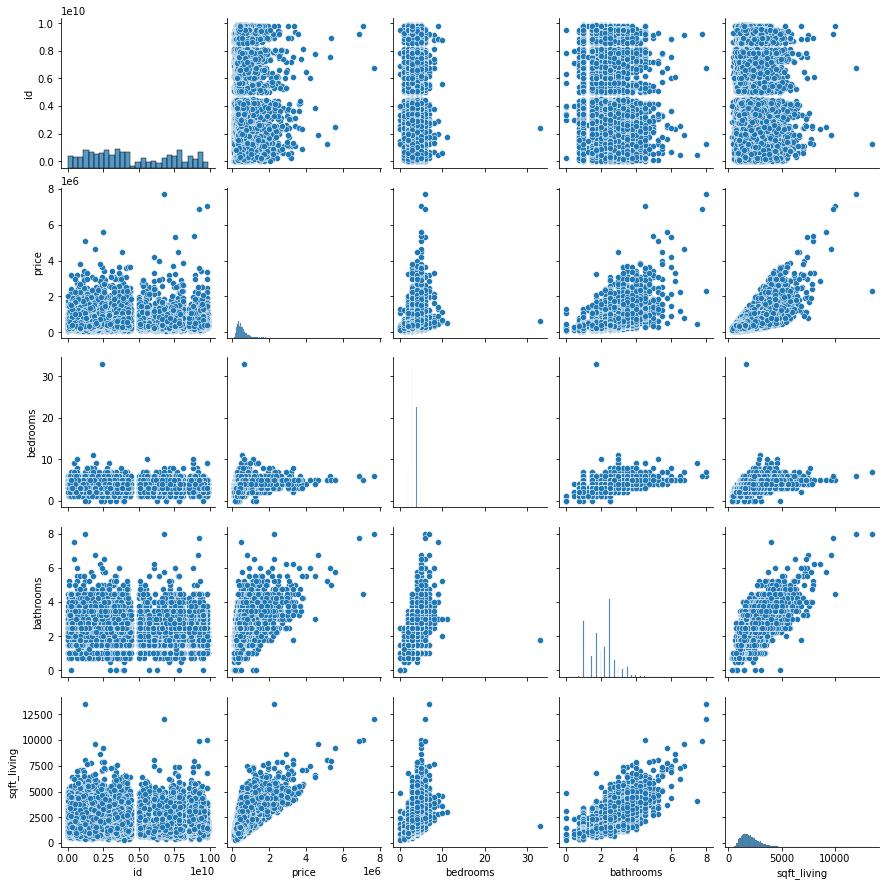

In [64]:
sns.pairplot(dataset)

° Conclusões das análises gráficas realizadas anteriormente:

1) Podemos perceber que grande parte dos imóveis tem características nem parecidas como os números dos quartos dos imóveis que se concentram entre 1 e 5 quartos.

2) Podemos também perceber que o número de banheiros dos imóveis se concentram entre um e 4 banheiros e que poucos valores fogem aos números desta análise.

3) podemos perceber que a coluna de 'sqft_living' ou seja, metros quadrados dos imóveis, é a variável que tem maior correlação com os preços dos imóveis do dataset.

4) Analisando inicialmente o dataset completo, podemos perceber que outras variáveis se relacionam de forma objetiva com os preços dos imóveis como: 'waterfront'(vista para o mar), a 'view'(vista do imóvel), dentre outras.

5) Esse tipo de análise pode ajudar o setor imóbiliario a se ajustar aos desejos dos compradores sem ter que perder tempo demonstrando várias residências que não se aplicam nem aos orçamentos dos seus clientes, nem aos desejos desses.

